<a href="https://colab.research.google.com/github/justine-cohen/chatgpt/blob/main/Copy_of_Introduction_to_Artificial_Intelligence_Computer_Vision_and_Image_Processing_in_Python.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Introduction to Artificial Intelligence: Computer Vision and Image Processing in Python**


Based on: Nian Xiong, NCSU Libraries Workshop

>This workshop provides an introduction to basic image processing techniques using the OpenCV computer vision library and some standard data analysis libraries in Python. OpenCV (Open Source Computer Vision Library) is an open source computer vision and machine learning software library.

**Knowledge of image processing and Python programming is not required for this workshop, but will help**.

*The source of this notebook is located at https://github.com/xn2333/OpenCV/blob/master/Seminar_Image_Processing_in_Python.ipynb*

*Useful intro about [Colab](https://colab.research.google.com/notebooks/welcome.ipynb)*

*Useful intro about [OpenCV](https://opencv.org/)*







### **----------------------------------------------------------------------**




###              **Libraries**








### **----------------------------------------------------------------------**





##Step1: Load the Dependencies

> This section loads some required libraries used in this notebook: **numpy**, **pandas**, **cv2**, **skimage**, **PIL**, **matplotlib**

*   [Numpy](https://www.numpy.org/) is an array manipulation library, used for linear algebra, Fourier transform, and random number capabilities.
*   [Pandas](https://pandas.pydata.org/) is a library for data manipulation and data analysis.
*   [CV2](https://docs.opencv.org/4.x/d6/d00/tutorial_py_root.html) is the OpenCV library for computer vision tasks.
*   [Skimage](https://scikit-image.org/) is a library which supports image processing applications on Python.
*   [Matplotlib](https://matplotlib.org/) is a library which generates figures and provides graphical user interface toolkit.









In [1]:
# importing libaray
# import "library name"  as  "alias name"
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from PIL import Image
import matplotlib.pylab as plt

##Step2: Read Image from Urls

> In this step we will read images from urls, and display them using openCV, please note the difference when reading image in RGB and BGR format. The default input color channels are in BGR format for openCV.
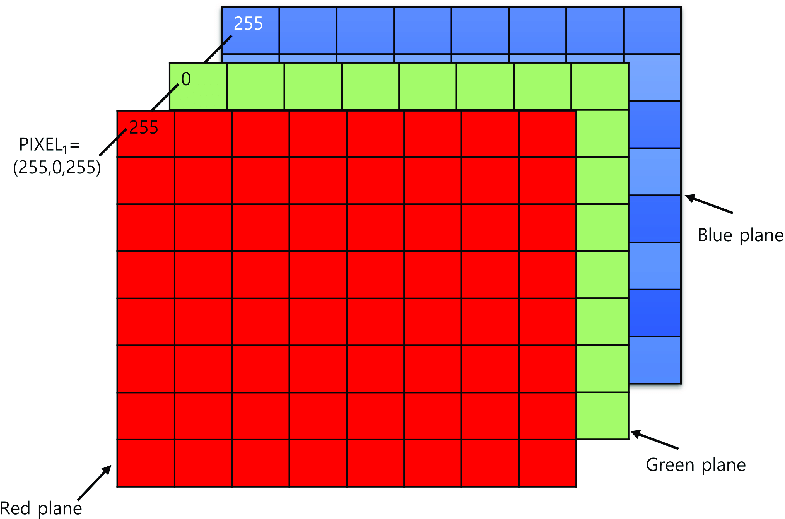


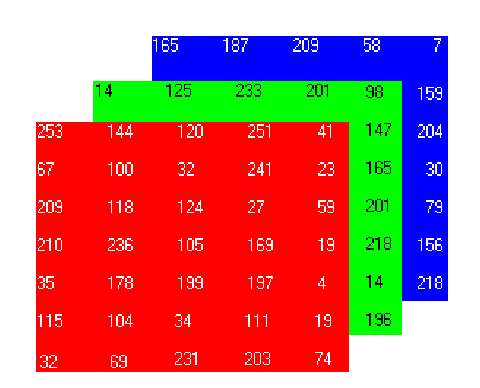


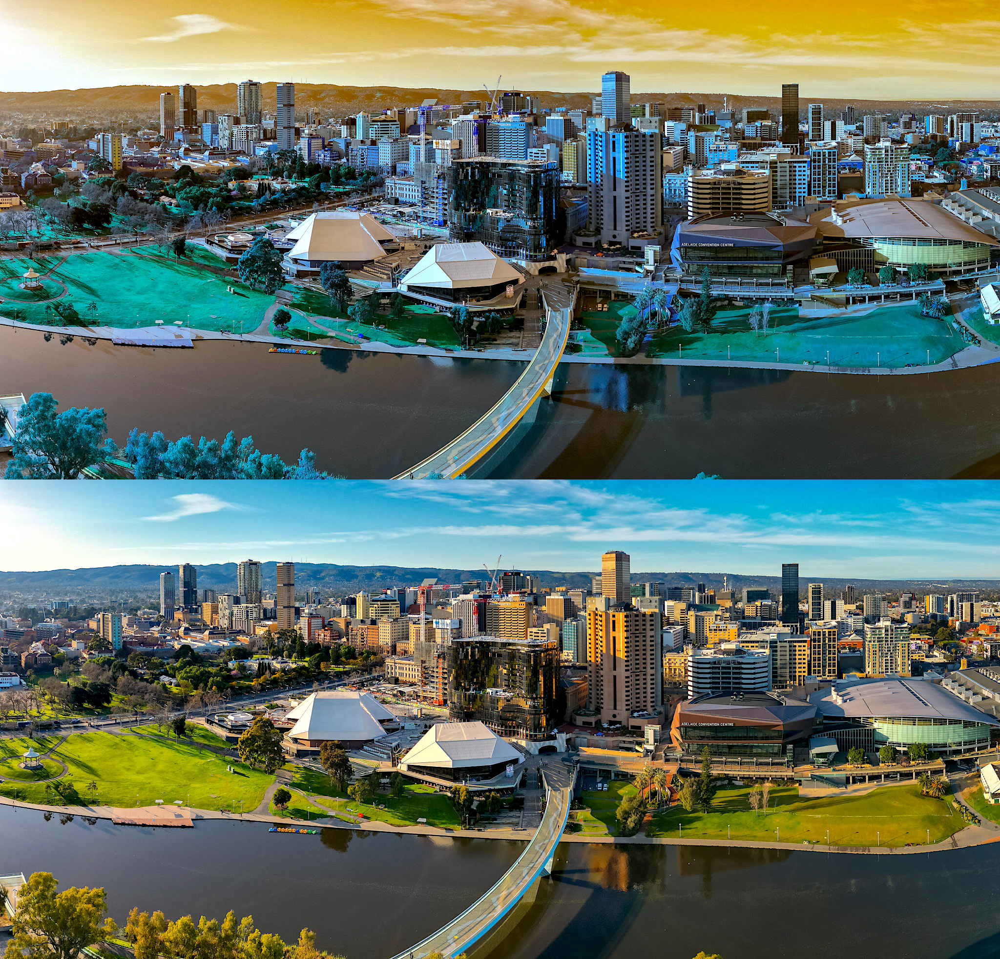

In [43]:
# Create a list to store the urls of the images
urls = ["https://upload.wikimedia.org/wikipedia/commons/8/8e/Adelaide_skyline%2C_December_2022.jpg"]


# loop over the image URLs, you could store several image urls in the list
for item in urls:
  # Read and display the image
  image = io.imread(item)
  # convert the colour space of the read image from BGR into RGB
  image_2 = cv.cvtColor(image, cv.COLOR_BGR2RGB)
  # combine (concatenate) images horizontally. Images can be combined vertically with the cv.vconcat instruction
  final_frame = cv.vconcat((image, image_2))
  # display images
  cv2_imshow(final_frame)
  print('\n')

# Excercise 1:
### - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
### use the above code and do the following:
###a)remove "print('\n') and record the results
###b)use cv.vconcat in the above code and display the images
###c)Read an image from a URL and save it in '**`myImg`**' and display it

Image source examples:

[Place Kitten](https://placekitten.com/) - use the base Place Kitten URL followed by a width and height separated by backslashes ''/''. For example, use the URL `https://placekitten.com/500/300` to fetch a cat image with a width of 500px and height of 300px.


In [23]:
# LOAD IMAGE
# url ="https://upload.wikimedia.org/wikipedia/commons/8/8e/Adelaide_skyline%2C_December_2022.jpg"
# myImg = io.imread(url)
# cv2_imshow(cv.cvtColor(myImg, cv.COLOR_BGR2RGB))





### **----------------------------------------------------------------------**




###              **Extract Image information**








### **----------------------------------------------------------------------**

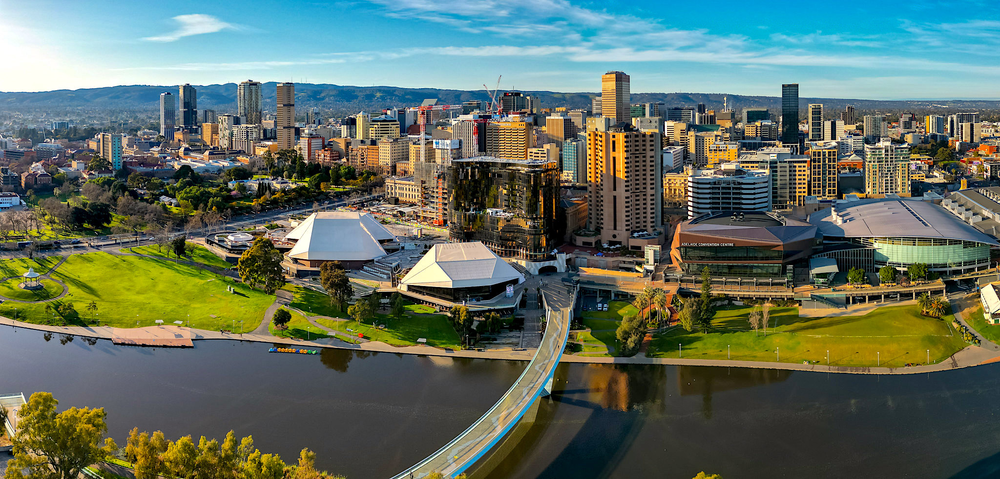

uint8
983
2048
3


In [16]:
# Load an image from the below link, read it and change its colour space.
url= "https://upload.wikimedia.org/wikipedia/commons/8/8e/Adelaide_skyline%2C_December_2022.jpg"
image = io.imread(url)
cv2_imshow(cv.cvtColor(image, cv.COLOR_BGR2RGB))

# Check the image matrix data type and dimensions (could know the bit depth of the image)
print(image.dtype)
# Check the height of image
print(image.shape[0])
# Check the width of image
print(image.shape[1])
# Check the number of channels of the image
print(image.shape[2])

### **----------------------------------------------------------------------**




###              **Histogram**








### **----------------------------------------------------------------------**

##Step3: Image Histograms

### Generate Histogram of color image and grayscale image
Sometimes, we need to enhance the contrast in an image or to expand the contrast in a particular region while sacrificing the detail in colors that don’t vary much, or don’t matter. A good tool to find interesting regions is the **histogram**. To create a **histogram** of our image data, we use the matplot.pylab `hist()` function.

More info: [Histogram](https://docs.opencv.org/3.4.15/d4/d1b/tutorial_histogram_equalization.html)

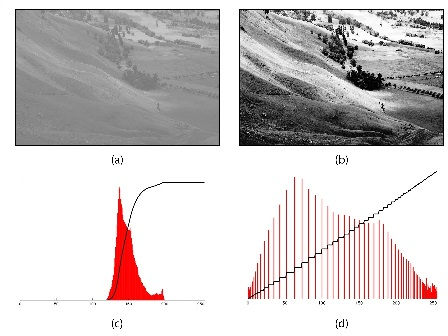

###The following code is to display the histogram of all the pixels in the colour image

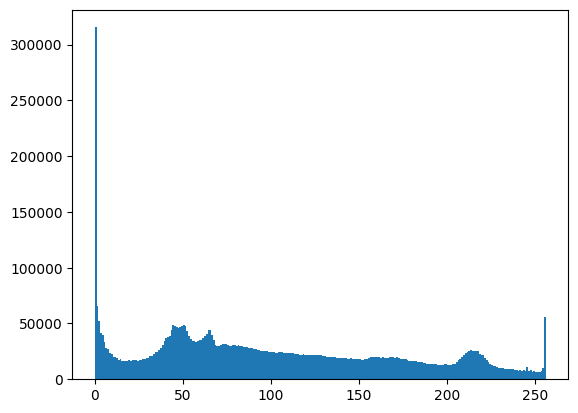

In [18]:
# display the histogram of the image using 'hist' function
plt.hist(image.ravel(),bins = 256, range = [0,256])
# create a figure to display the image
plt.show()

###Display the histogram of R, G, B channel


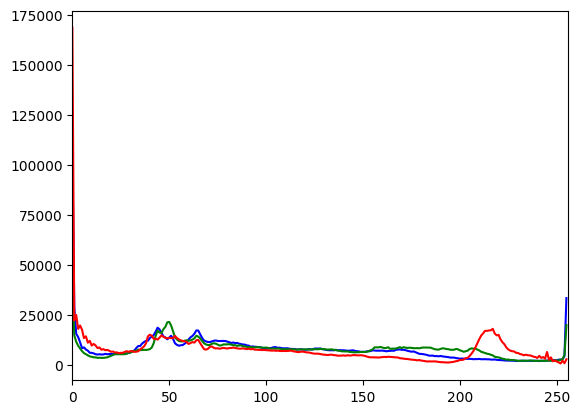

In [17]:
color = ('b','g','r')
# create a loop using for statment to loop three times over 'b', 'g', and 'r' in the tuple color
for i,col in enumerate(color): # where i is the current iteration and col is the pixel value at the current iteration
    histr = cv.calcHist([image],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

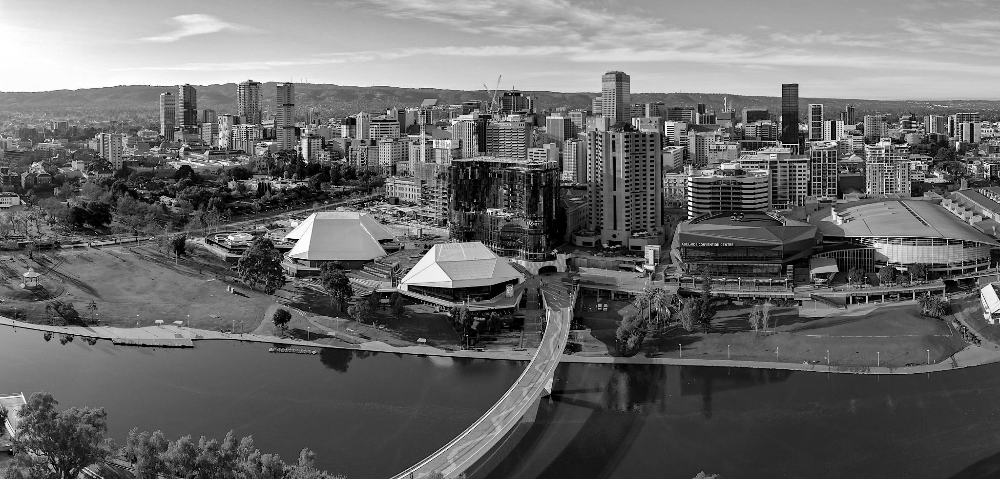

In [19]:
# change the image into gray scale image
gray_image = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
cv2_imshow(gray_image)

In [20]:
# print the dimensions of the colour image
print(image.shape)

(983, 2048, 3)


In [21]:
# print the dimensions of the gray scale image
print(gray_image.shape)

(983, 2048)


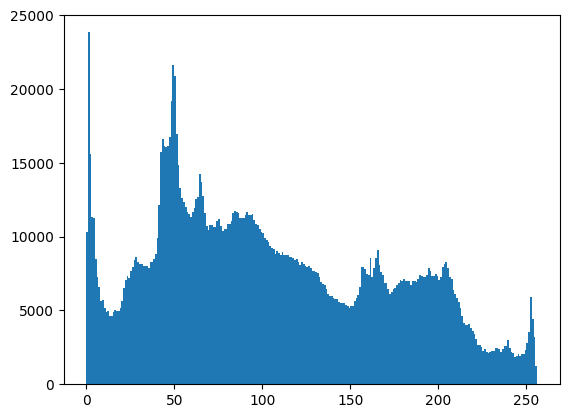

In [22]:
# Plot the histogram of the gray image. We could observe that the frequency of the image hist has decreased ~ 1/3 of the histogram of color image
plt.hist(gray_image.ravel(),bins = 256, range = [0, 256])
plt.show()

 # Excercise 2:
### - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

 Use your image '**`myImg`**' and display its grayscale of its colour version and generate histogram


In [24]:
#myGrayImg = cv.cvtColor(myImg, cv.COLOR_BGR2GRAY)
#cv2_imshow()

### **----------------------------------------------------------------------**




###              **Contour**








### **----------------------------------------------------------------------**


##Step4: Image Contours

## Find image contour of the grayscale image

Image contouring is process of identifying structural outlines of objects in an image which in turn can help us identify shape of the object.

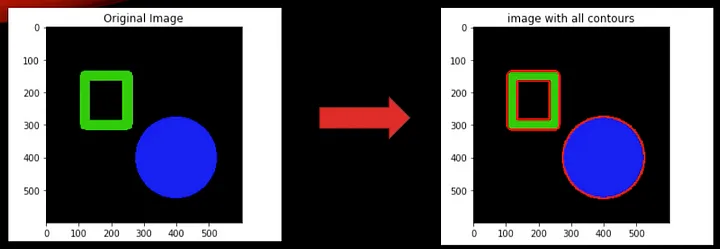


https://evergreenllc2020.medium.com/fundamentals-of-image-contours-3598a9bcc595#:~:text=of%20image%20contours-,What%20is%20image%20contour%3F,identify%20shape%20of%20the%20object.

###Method 1: Use the matplotlib. contour

More Info: [matplotlib contour](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.contour.html)

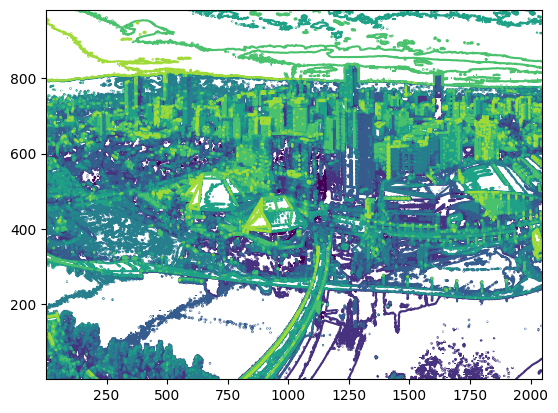

In [34]:
plt.contour(gray_image, origin = "image")

### Method 2: Use the openCV library

More info: [Contour](https://docs.opencv.org/3.1.0/d4/d73/tutorial_py_contours_begin.html)

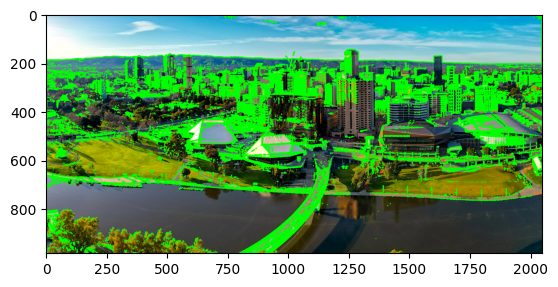

In [35]:
# Set threshold for the countour detection
ret, thresh = cv.threshold(gray_image,150,255,0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
cv.drawContours(image, contours, -1, (0, 255, 0), 3)
plt.imshow(image)
#plt.imshow(thresh)

# Excercise 3:
### - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Use your image '**`myImg`**' and '**`myGrayImg`**' to find its contour

In [36]:
# Your code
# plt.contour()

### **----------------------------------------------------------------------**




###              **Mathmatical Transformations**








### **----------------------------------------------------------------------**


## Step5: Grayscale Transform

### Grayscale Transformation
This section provides some examples of conducting mathematical transformations of the grayscale image

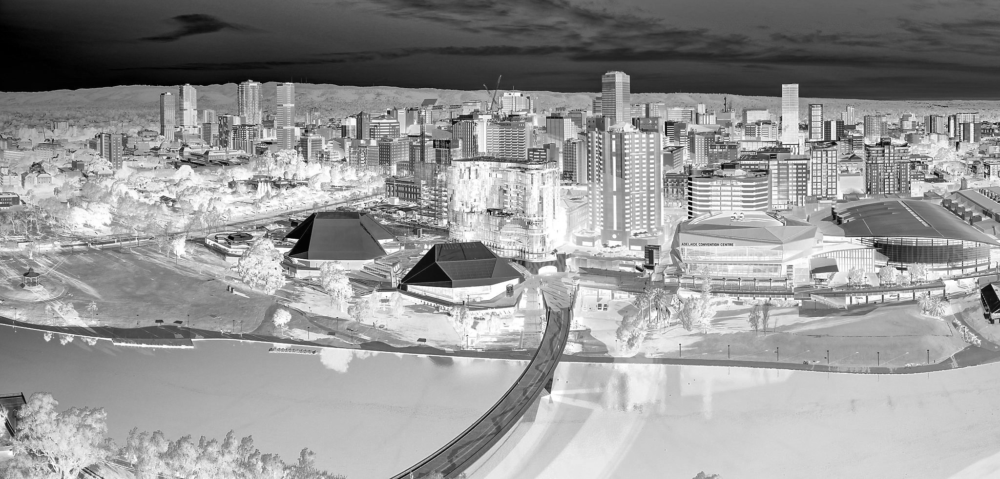

In [31]:
# This is an inverse operation of the grayscale image, you could see that the
# bright pixels become dark, and the dark pixels become bright
im2 = 255 - gray_image
cv2_imshow(im2)

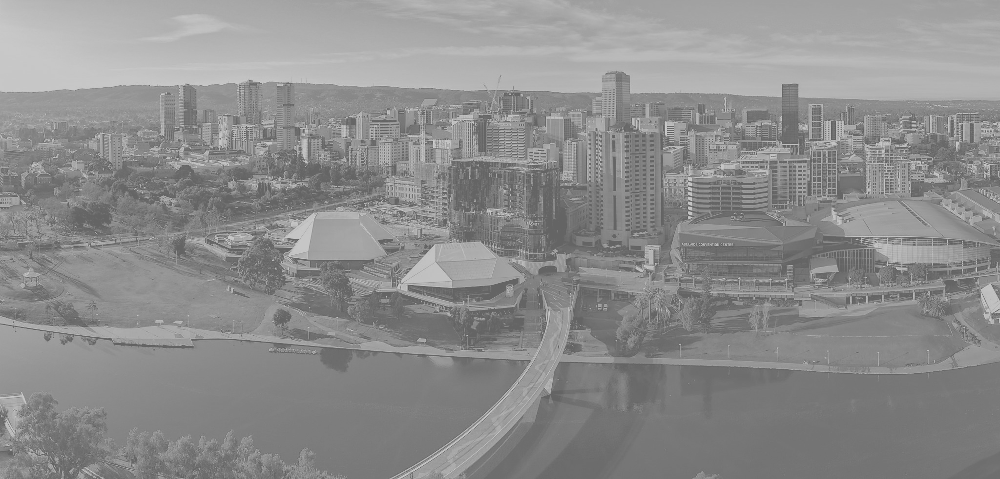

In [32]:
# Another transform of the image, after adding a constant,
# all the pixels become brighter and a hazing-like effect of the image is generated (smoother image)
im3 = (100.0/255)*gray_image + 100
cv2_imshow(im3)

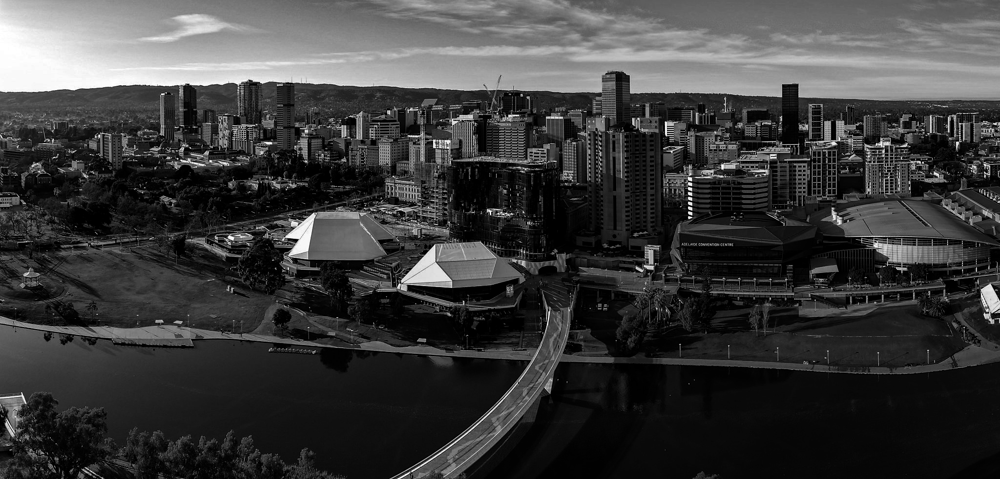

In [37]:
# The lightness level of the gray_image decreases after this step
im4 = 255.0*(gray_image/255.0)**2
cv2_imshow(im4)

# Excercise 4:
### - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Use your image '**`myGrayImg`**' and try some mathematical operations on your image


In [30]:
## Implement your code here
## myGrayImgTrans = myGrayImg...
## cv2_imshow(myGrayImgTrans)

### **----------------------------------------------------------------------**




###              **Histogram Equalization**








### **----------------------------------------------------------------------**


## Step6: Histogram Equalization

This section demonstrates histogram equalization on a dark image. This transform flattens the gray-level histogram so that all intensities are as equally common as possible. https://docs.opencv.org/3.4.15/d4/d1b/tutorial_histogram_equalization.html




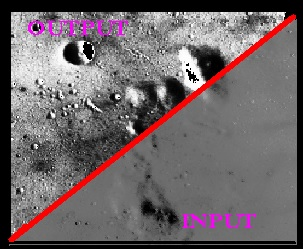



In [38]:
# Apply image histogram equalization
eqim = cv.equalizeHist(gray_image)

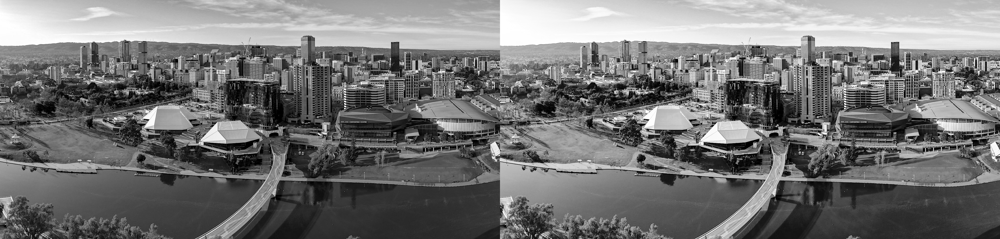

In [39]:
# put the two images in one row
res = np.hstack((gray_image, eqim))

# Display the image
cv2_imshow(res)

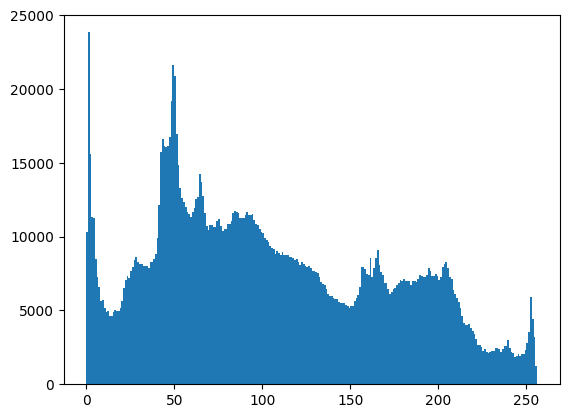

In [28]:
# Extra: try to visualize the histogram of the image after histogram equalization
# Before histogram equalization
plt.hist(gray_image.ravel(),bins = 256, range = [0, 256])
plt.show()

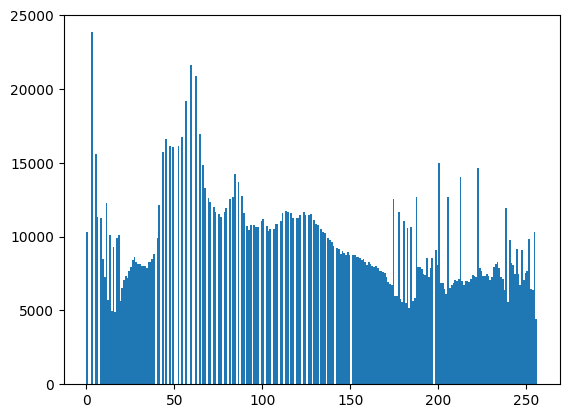

In [29]:
# After histogram equalization
plt.hist(eqim.ravel(),bins = 256, range = [0, 256])
plt.show()

# Excercise 5:
### - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Use your image '**`myGrayImg`**' and perform a histogram equalization on your grayscale image



In [42]:
## TODO: IMPLEMENT YOUR CODE HERE
## CODE INSTRUCTION
##plt.imshow()